In [1]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import Counter

import re

In [2]:
# nltk.download()

In [3]:
df_verslagen = pd.read_csv('a:/bloeding-met-patientenlijst-2/bloeding-met-patientenlijst-4-verslagen.csv')
df_verslagen

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00
...,...,...,...,...
9572,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,Consult,Samenvatting: \n1e consult\r\n-Type 1e consult...,2015-03-20 08:13:00
9573,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, Kliniek: vervolgconsult",Samenvatting: \nDecursus\r\n-Type decursus: De...,2015-01-14 15:39:00
9574,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nVerpleegkundige verslaglegging...,2014-12-21 09:31:00
9575,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nMedisch Dossier\r\n[ Vk Sputov...,2010-11-10 21:03:00


In [4]:
df_verslagen['verslagen_report_content'][0], df_verslagen['verslagen_report_content'][1]

('Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] NR  [CITY]\r\n\r\n\r\n\r\n\r\n\r\ndatum\r\n29-11-2020\r\nkenmerk\r\n0007475372 / [PATIENTID]\r\nBSN nr.\r\n[BSN]\r\nbetreft\r\nmevrouw [INITIALS] [LASTNAME], geb. [BIRTHDATE] (87)\r\n[STREETNAME], [ZIP]  [CITY]\r\ntel. [PHONENUMBER]\r\n\r\n \r\nGeachte collega,\r\n\r\nBovengenoemde patiënte was opgenomen van 24-11-2020 tot en met 26-11-2020 op de afdeling Maag-, Darm- en Leverziekten in verband met melaena en rectaal bloedverlies. \r\n\r\nVoorgeschiedenis\r\n2002 Diep veneuze trombose en longembolie\r\n2013 Cholecystectomie\r\n2015 Diverticulitis\r\n2016 Atriumfibrilleren met spontane conversie naar sinusritme\r\n2016 Melena, waarvoor geen verklaring werd gevonden. In verband met stabiel Hb en in overleg met patiënte expectatief beleid. \r\n2018 Vermoeidheid bij sinusbradycardie waarvoor stop metoprolol en tambocor. \r\n\r\nAnamnese\r\nVanmiddag rond 13.30u fors helderrood bloedverlies met stolsels. Vermengd met ontlasting, mogelijk was d

In [5]:
# import nltk
# import ssl

# try:
#     _create_unverified_https_context = ssl._create_unverified_context
# except AttributeError:
#     pass
# else:
#     ssl._create_default_https_context = _create_unverified_https_context

# nltk.download('stopwords')
# nltk.download('wordnet')

In [6]:
# clean text
def clean_text(text):
    # remove punctuation
    text = ''.join([word for word in text if word not in string.punctuation])
    # remove stopwords
    text = ' '.join([word for word in text.split() if word.lower() not in stopwords.words('dutch')])
    # remove numbers
    text = ''.join([word for word in text if not word.isdigit()])
    # make everything lowercase
    text = text.lower()
    return text


test = clean_text(df_verslagen['verslagen_report_content'][0])
print(test)


dhr aj dingemans huisarts streetname nr city datum  kenmerk  patientid bsn nr bsn betreft mevrouw initials lastname geb birthdate  streetname zip city tel phonenumber geachte collega bovengenoemde patiënte opgenomen   afdeling maag darm leverziekten verband melaena rectaal bloedverlies voorgeschiedenis  diep veneuze trombose longembolie  cholecystectomie  diverticulitis  atriumfibrilleren spontane conversie sinusritme  melena waarvoor verklaring gevonden verband stabiel hb overleg patiënte expectatief beleid  vermoeidheid sinusbradycardie waarvoor stop metoprolol tambocor anamnese vanmiddag rond u fors helderrood bloedverlies stolsels vermengd ontlasting mogelijk zwart kleur sinds  dagen zeurende pijn bovenbuik maagpijn waarvoor gestopt koffie drinken vet eten afgelopen dagen minder ontlasting minder intake bloed zwart verkleuring bemerkt tractus anamnese verder bijdragend mn lwklachten all penicillines urticaria lichamelijk onderzoek controles spo  hr bpm  nibp mmhg  temp °c  alg acuu

In [7]:
clean_text_list = []
for i in range(len(df_verslagen)):
    cleaned_text = clean_text(df_verslagen['verslagen_report_content'][i])
    clean_text_list.append(cleaned_text)
    

df_verslagen['verslagen_report_content_cleaned'] = clean_text_list

In [8]:
# pip install spacy-lookups-data


In [9]:
df_verslagen_clean = df_verslagen.copy()

In [10]:
df_verslagen_clean['content_words'] = df_verslagen_clean['verslagen_report_content_cleaned']

In [11]:
words_list = []
for i in range(len(df_verslagen)):
    df_verslagen_clean['content_words'][i] = df_verslagen_clean['content_words'][i].split()

df_verslagen_clean.head()

C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\3888130432.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words'][i] = df_verslagen_clean['content_words'][i].split()
C:\Users\Y.vanMegen\AppData\Local\T

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig..."


In [12]:
all_words = []

for i in range(len(df_verslagen_clean)):
    for j in range(len(df_verslagen_clean['content_words'][i])):
        word = df_verslagen_clean['content_words'][i][j]
        all_words.append(word)

all_words

['dhr',
 'aj',
 'dingemans',
 'huisarts',
 'streetname',
 'nr',
 'city',
 'datum',
 'kenmerk',
 'patientid',
 'bsn',
 'nr',
 'bsn',
 'betreft',
 'mevrouw',
 'initials',
 'lastname',
 'geb',
 'birthdate',
 'streetname',
 'zip',
 'city',
 'tel',
 'phonenumber',
 'geachte',
 'collega',
 'bovengenoemde',
 'patiënte',
 'opgenomen',
 'afdeling',
 'maag',
 'darm',
 'leverziekten',
 'verband',
 'melaena',
 'rectaal',
 'bloedverlies',
 'voorgeschiedenis',
 'diep',
 'veneuze',
 'trombose',
 'longembolie',
 'cholecystectomie',
 'diverticulitis',
 'atriumfibrilleren',
 'spontane',
 'conversie',
 'sinusritme',
 'melena',
 'waarvoor',
 'verklaring',
 'gevonden',
 'verband',
 'stabiel',
 'hb',
 'overleg',
 'patiënte',
 'expectatief',
 'beleid',
 'vermoeidheid',
 'sinusbradycardie',
 'waarvoor',
 'stop',
 'metoprolol',
 'tambocor',
 'anamnese',
 'vanmiddag',
 'rond',
 'u',
 'fors',
 'helderrood',
 'bloedverlies',
 'stolsels',
 'vermengd',
 'ontlasting',
 'mogelijk',
 'zwart',
 'kleur',
 'sinds',
 'dag

In [13]:
amount_of_words = Counter(all_words)
amount_of_words

Counter({'mg': 14109,
         'x': 11805,
         'per': 11330,
         'beleid': 10702,
         'dd': 10493,
         'samenvatting': 9795,
         'dag': 9771,
         'onderzoek': 8159,
         'oraal': 7771,
         'anemie': 7405,
         'stuk': 7362,
         'ivm': 7112,
         'opname': 7042,
         'mmoll': 6390,
         'conclusie': 6216,
         'tablet': 6213,
         'hb': 5936,
         'anamnese': 5786,
         'poli': 5192,
         'waarvoor': 5158,
         'rechts': 5083,
         'opdrachten': 5048,
         'lab': 4747,
         'links': 4602,
         'controle': 4600,
         'voorgeschiedenis': 4573,
         'goed': 4474,
         'l': 4316,
         'medicatie': 4314,
         'hypertensie': 4247,
         'bloedverlies': 4218,
         'wel': 4201,
         'b': 4151,
         'afspraak': 3902,
         'patiënt': 3822,
         'beloop': 3685,
         'dr': 3543,
         'start': 3515,
         'klachten': 3329,
         'a': 3299,
     

In [14]:
cleaned_df = df_verslagen_clean.copy()

In [15]:
# Checking the data and common words
num_verslagen = len(cleaned_df)
cleaned_df['word_count'] = cleaned_df['verslagen_report_content_cleaned'].apply(lambda x: len(x.split()))
avg_words_per_article = cleaned_df['word_count'].mean()
all_words = ' '.join(cleaned_df['verslagen_report_content_cleaned']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

cleaned_df['tokens'] = cleaned_df['verslagen_report_content_cleaned'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in cleaned_df['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1555455
Average words per article: 162.4156834081654
Number of unique words: 30757
Lexical richness: 0.019773635367143376
Most common 100 words:
mg: 14109
x: 11805
per: 11330
beleid: 10702
dd: 10493
samenvatting: 9795
dag: 9771
onderzoek: 8159
oraal: 7771
anemie: 7405
stuk: 7362
ivm: 7112
opname: 7042
mmoll: 6390
conclusie: 6216
tablet: 6213
hb: 5936
anamnese: 5786
poli: 5192
waarvoor: 5158
rechts: 5083
opdrachten: 5048
lab: 4747
links: 4602
controle: 4600
voorgeschiedenis: 4573
goed: 4474
l: 4316
medicatie: 4314
hypertensie: 4247
bloedverlies: 4218
wel: 4201
b: 4151
afspraak: 3902
patiënt: 3822
beloop: 3685
dr: 3543
start: 3515
klachten: 3329
a: 3299
aanvullend: 3250
pijn: 3242
af: 3242
wv: 3232
seh: 3217
gezien: 3124
bekende: 3083
gehad: 3059
lichamelijk: 3053
int: 2968
mogelijk: 2947
interne: 2943
voltooid: 2938
type: 2887
xl: 2840
sinds: 2823
ul: 2801
gastroscopie: 2748
e: 2703
bloeding: 2621
huisarts: 2612
afwijkingen: 2593
knoppen: 

In [16]:
cleaned_df.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,word_count,tokens
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...",468,"[dhr, aj, dingemans, huisarts, streetname, nr,..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...",111,"[samenvatting, rectaal, bloedverlies, obv, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...",144,"[coloscopie, betreft, mw, initials, lastname, ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...",80,"[gastroscopie, betreft, mw, initials, lastname..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...",147,"[samenvatting, rectaal, bloedverlies, eenmalig..."


In [17]:

unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


cleaned_df['verslagen_report_content_cleaned_filtered'] = cleaned_df['verslagen_report_content_cleaned'].apply(remove_words)

In [18]:
# Checking the data and common words
num_verslagen = len(cleaned_df)
cleaned_df['word_count'] = cleaned_df['verslagen_report_content_cleaned_filtered'].apply(lambda x: len(x.split()))
avg_words_per_article = cleaned_df['word_count'].mean()
all_words = ' '.join(cleaned_df['verslagen_report_content_cleaned_filtered']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

cleaned_df['tokens'] = cleaned_df['verslagen_report_content_cleaned_filtered'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in cleaned_df['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1331511
Average words per article: 139.03216038425393
Number of unique words: 30703
Lexical richness: 0.023058765567839846
Most common 100 words:
onderzoek: 8159
oraal: 7771
anemie: 7405
opname: 7042
tablet: 6213
hb: 5936
poli: 5192
lab: 4747
controle: 4600
l: 4316
medicatie: 4314
hypertensie: 4247
bloedverlies: 4218
b: 4151
afspraak: 3902
patiënt: 3822
start: 3515
klachten: 3329
a: 3299
pijn: 3242
af: 3242
wv: 3232
seh: 3217
lichamelijk: 3053
int: 2968
interne: 2943
type: 2887
xl: 2840
ul: 2801
gastroscopie: 2748
e: 2703
bloeding: 2621
afwijkingen: 2593
knoppen: 2554
ontlasting: 2514
nee: 2450
mdl: 2408
coloscopie: 2343
h: 2334
laboratorium: 2327
rr: 2296
gaat: 2295
hemoglobine: 2282
morgen: 2280
decursus: 2274
d: 2265
egfr: 2219
diabetes: 2180
mcv: 2173
normale: 2169
bloed: 2167
chronische: 2106
iv: 2105
atriumfibrilleren: 2094
recidief: 2078
consult: 2014
milde: 1999
stabiel: 1996
normaal: 1990
laatste: 1967
via: 1964
iom: 1932
rectaal

In [19]:
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['verslagen_report_content_cleaned']
df_verslagen_clean.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...",dhr aj dingemans huisarts streetname nr city d...
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...",samenvatting rectaal bloedverlies obv divertik...
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...",coloscopie betreft mw initials lastname adresg...
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...",gastroscopie betreft mw initials lastname adre...
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...",samenvatting rectaal bloedverlies eenmalig hd ...


In [20]:
# lemmatizer = WordNetLemmatizer()

# words_list = []
# for i in range(len(df_verslagen_clean)):
#     lst_words = df_verslagen_clean['content_words_lemmatized'][i]
#     lemmatized_words = [lemmatizer.lemmatize(word) for word in lst_words]
#     print(lemmatized_words)
#     df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words

# df_verslagen_clean.head()

In [21]:
import sys
print(f"Python {sys.version_info.major}.{sys.version_info.minor}.{sys.version_info.micro}")


Python 3.11.6


In [22]:
# pip install "C:/Users/Y.vanMegen/Downloads/nl_core_news_sm-3.8.0.tar.gz"


In [23]:
import spacy

nlp = spacy.load("nl_core_news_sm")

In [24]:
import spacy
nlp = spacy.load("nl_core_news_sm")
print("Model loaded successfully!")


Model loaded successfully!


In [25]:
df_verslagen_clean['verslagen_report_content_cleaned'][0] 

'dhr aj dingemans huisarts streetname nr city datum  kenmerk  patientid bsn nr bsn betreft mevrouw initials lastname geb birthdate  streetname zip city tel phonenumber geachte collega bovengenoemde patiënte opgenomen   afdeling maag darm leverziekten verband melaena rectaal bloedverlies voorgeschiedenis  diep veneuze trombose longembolie  cholecystectomie  diverticulitis  atriumfibrilleren spontane conversie sinusritme  melena waarvoor verklaring gevonden verband stabiel hb overleg patiënte expectatief beleid  vermoeidheid sinusbradycardie waarvoor stop metoprolol tambocor anamnese vanmiddag rond u fors helderrood bloedverlies stolsels vermengd ontlasting mogelijk zwart kleur sinds  dagen zeurende pijn bovenbuik maagpijn waarvoor gestopt koffie drinken vet eten afgelopen dagen minder ontlasting minder intake bloed zwart verkleuring bemerkt tractus anamnese verder bijdragend mn lwklachten all penicillines urticaria lichamelijk onderzoek controles spo  hr bpm  nibp mmhg  temp °c  alg acu

In [26]:
# lst_words = df_verslagen_clean['content_words_lemmatized'][i]
# lemmatized_words = nlp(' '.join(lst_words))
# lemmatized_words

# for token in lemmatized_words:
#     print(f"word: {token.text}, lemm_word: {token.lemma_}")

In [27]:
# # lemmatizer = WordNetLemmatizer()

words_list = []
for i in range(len(df_verslagen_clean)):
    print(i)
    words = df_verslagen_clean['content_words_lemmatized'][i]
    # print('words:', words)
    doc = nlp(words)   
    # print('doc:', doc)
    lemmatized_words  = [token.lemma_ for token in doc]
    # print('lemmatized_words:', lemmatized_words)
    # for token in lemmatized_words:
    #     print(f"word: {token.text}, lemm_word: {token.lemma_}")
    df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words

df_verslagen_clean.head()

0
1
2
3
4
5


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6
7
8
9
10
11
12
13


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

14
15
16
17
18
19
20
21
22
23
24


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

25
26
27
28
29
30
31
32
33
34
35
36
37


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

38
39
40
41
42
43


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

44
45
46
47


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

48
49
50
51
52
53


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

54
55
56
57
58
59
60
61
62


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

63
64
65
66


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

67
68
69
70
71


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

72
73
74
75
76
77
78
79
80


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

81
82
83
84
85
86


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

87
88
89
90
91
92


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

93
94
95
96
97
98


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

99
100
101
102
103
104
105


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

106
107
108
109
110
111


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

112
113
114
115
116
117
118
119
120


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

121
122
123
124
125
126
127
128
129
130


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

131
132
133
134
135
136
137


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

138
139
140
141
142


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

143
144
145
146
147
148
149
150
151
152
153


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

154
155
156
157
158


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

159
160
161
162
163
164
165
166


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

167
168
169
170
171
172
173
174


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

175
176
177
178
179
180
181
182


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

183
184
185
186
187
188
189


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

190
191
192
193
194
195
196


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

197
198
199
200
201
202
203


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

204
205
206
207
208
209


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

210
211
212
213
214


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

215
216
217
218
219
220
221


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

222
223
224
225
226
227


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

228
229
230
231
232


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

233
234
235
236


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

237
238
239


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

240
241
242
243
244
245
246


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

247
248
249


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

250
251
252
253
254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

255
256
257
258
259


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

260
261
262
263
264


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

265
266
267
268
269
270
271
272


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

273
274
275
276
277
278
279
280


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

281
282
283
284
285
286
287


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

288
289
290
291
292
293
294
295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

296
297
298
299
300
301
302
303
304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

305
306
307
308
309
310
311
312


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

313
314
315
316
317
318
319
320


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

321
322
323
324
325
326
327
328
329


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

330
331
332
333
334
335
336
337
338
339
340


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

341
342
343
344
345
346
347
348


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

349
350
351
352
353
354


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

355
356
357
358


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

359
360
361
362


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

363
364
365


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


366


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

367
368
369


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

370
371
372


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

373
374
375
376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

377
378
379


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

380
381
382


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

383
384
385
386


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

387
388
389
390
391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

392
393
394
395


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

396
397
398


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

399
400
401
402
403


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

404
405
406
407
408
409


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

410
411
412
413
414
415


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

416
417
418
419
420
421


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

422
423


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

424
425
426
427
428
429


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

430
431
432
433
434
435


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

436
437
438
439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

440
441
442
443
444


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

445
446
447
448
449


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

450
451
452
453
454


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

455
456
457
458
459
460


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

461
462
463


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

464
465
466
467


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

468
469
470
471
472
473
474
475
476
477


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

478
479
480
481
482
483
484
485


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

486
487
488
489
490
491
492
493


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

494
495
496
497
498
499
500
501
502
503
504


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

505
506
507
508
509
510
511
512
513
514
515


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

516
517
518
519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

520
521
522


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

523
524
525
526
527
528
529
530
531
532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

533
534
535
536


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

537
538
539
540
541


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

542
543
544
545
546


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

547
548
549


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

550
551
552
553
554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

555
556
557
558


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

559
560
561
562


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

563
564
565
566
567
568
569
570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

571
572
573
574


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

575
576
577
578
579


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

580
581
582
583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

584
585
586
587
588
589


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

590
591
592
593
594
595
596
597


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

598
599
600
601
602
603
604


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

605
606
607
608
609
610
611


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

612
613
614
615
616
617
618
619
620
621
622
623


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

624
625
626
627
628
629
630
631
632
633
634
635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

636
637
638
639
640
641
642
643


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

644
645
646
647
648
649
650
651


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

652
653
654
655
656
657


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

658
659
660
661
662
663
664
665
666
667
668
669
670


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

671
672
673
674
675
676
677
678
679
680
681
682
683


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

684
685
686
687
688
689
690
691
692
693
694
695


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

696
697
698
699
700
701
702
703
704
705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

706
707
708
709
710
711
712
713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

714
715
716
717
718
719


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

720
721
722
723
724
725
726
727
728
729
730
731
732
733


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

734
735
736
737
738
739
740


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

741
742
743
744
745
746
747
748
749
750
751
752
753
754
755
756


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

757
758
759
760
761
762
763
764
765
766
767
768
769
770
771
772
773


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

774
775
776
777
778
779
780
781
782
783
784
785
786
787
788
789
790
791
792
793
794
795
796


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

797
798
799
800
801
802
803
804
805
806


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

807
808
809
810
811
812
813
814
815
816
817
818
819
820
821
822
823
824


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

825
826
827
828
829
830
831
832
833
834
835
836
837
838
839
840
841


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

842
843
844
845
846
847
848


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

849
850
851
852
853
854


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

855
856
857
858
859


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

860
861
862


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

863
864
865
866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

867
868
869
870
871
872


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

873
874
875
876
877
878


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

879
880
881
882
883


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

884
885
886


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

887
888
889
890


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

891
892
893
894
895


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

896
897
898
899
900


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

901
902
903


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

904
905
906
907


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

908
909
910
911


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

912
913
914
915
916
917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

918
919
920


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

921
922
923
924
925
926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

927
928
929
930
931


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

932
933


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

934
935
936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

937
938
939
940


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

941
942
943
944
945


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

946
947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

948
949
950
951


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

952
953
954


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

955
956
957
958


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

959
960
961
962


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

963
964


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

965
966
967
968
969


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

970
971
972
973
974
975


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

976
977
978
979


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

980
981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

982
983
984
985
986


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

987
988
989
990
991


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

992
993
994


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

995
996


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

997
998
999
1000
1001


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1002
1003
1004
1005
1006


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1007
1008
1009
1010


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1011
1012
1013
1014
1015


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1016
1017
1018
1019
1020
1021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1022
1023
1024
1025
1026
1027


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1028
1029


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1030
1031
1032
1033
1034
1035


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1036
1037
1038


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1039
1040
1041
1042


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1043
1044
1045
1046
1047


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1048
1049
1050
1051
1052
1053
1054
1055
1056


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1057
1058
1059
1060
1061


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1062
1063
1064
1065
1066
1067
1068


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1069
1070
1071
1072
1073
1074
1075
1076
1077
1078
1079


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1080
1081
1082
1083
1084
1085
1086
1087
1088


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1089
1090
1091
1092
1093
1094
1095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1096
1097


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1098
1099
1100
1101
1102
1103
1104
1105
1106


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1107
1108
1109
1110
1111
1112
1113
1114
1115
1116


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1117
1118
1119
1120
1121
1122
1123
1124
1125
1126


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1127
1128
1129
1130


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1131
1132
1133
1134


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1135
1136
1137
1138
1139
1140


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1141
1142
1143
1144
1145


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1146
1147
1148
1149
1150
1151
1152


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1153
1154
1155
1156
1157
1158
1159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1160
1161
1162
1163
1164
1165


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1166
1167
1168
1169


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1170
1171
1172
1173


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1174
1175
1176
1177


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1178
1179
1180
1181
1182
1183
1184


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1185
1186
1187


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1188
1189
1190
1191
1192
1193
1194
1195
1196
1197
1198


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1199
1200
1201
1202
1203
1204
1205


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1206
1207
1208
1209
1210


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
1221
1222


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1223
1224
1225
1226
1227
1228
1229
1230
1231
1232
1233
1234


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1235
1236
1237
1238
1239
1240
1241
1242
1243
1244
1245
1246
1247


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1248
1249
1250
1251
1252
1253
1254
1255
1256


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1257
1258
1259
1260
1261
1262
1263
1264
1265
1266
1267
1268
1269


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1270
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1281
1282
1283
1284
1285
1286
1287
1288
1289
1290


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1291
1292
1293
1294
1295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1296
1297
1298


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1299
1300
1301
1302
1303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1304
1305
1306
1307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1308
1309
1310
1311


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1312
1313
1314
1315
1316
1317


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1318
1319
1320
1321
1322
1323
1324


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1325
1326
1327
1328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1329
1330
1331
1332
1333
1334
1335
1336


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1337
1338
1339
1340
1341
1342
1343


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1344
1345
1346
1347
1348
1349
1350
1351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1352
1353
1354
1355
1356


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1357
1358
1359
1360
1361
1362
1363


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1364
1365
1366
1367
1368
1369
1370
1371
1372


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1373
1374
1375
1376
1377
1378
1379


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1380
1381
1382
1383
1384
1385
1386
1387


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1388
1389
1390
1391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1392
1393
1394
1395
1396
1397
1398
1399


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1400
1401
1402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1403
1404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1405
1406
1407
1408
1409
1410
1411


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1412
1413
1414
1415
1416


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1417
1418
1419
1420
1421


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1422
1423
1424
1425
1426
1427


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1428
1429
1430
1431
1432
1433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1434
1435
1436
1437


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1438
1439
1440
1441
1442
1443


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1444
1445


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1446
1447
1448


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1449
1450
1451
1452
1453


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1454
1455
1456
1457


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1458
1459
1460


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1461
1462
1463
1464
1465
1466


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1467
1468
1469
1470


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1471
1472
1473
1474


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1475
1476
1477


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1478
1479
1480
1481
1482


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1483
1484
1485


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1486
1487
1488
1489
1490
1491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1492
1493
1494
1495
1496
1497


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1498
1499
1500
1501
1502
1503
1504
1505
1506
1507
1508


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1509
1510
1511
1512
1513
1514
1515
1516
1517
1518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1519
1520
1521
1522
1523


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1524
1525
1526
1527
1528
1529
1530
1531
1532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1533
1534
1535
1536
1537
1538
1539
1540
1541


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1542
1543
1544
1545
1546
1547


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1548
1549
1550
1551
1552
1553
1554
1555
1556
1557
1558


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1559
1560
1561
1562
1563
1564


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1565
1566
1567
1568
1569
1570
1571


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1572
1573
1574


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1575
1576
1577
1578
1579
1580
1581


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1582
1583
1584
1585
1586


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1587
1588
1589
1590
1591
1592
1593
1594
1595


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1596
1597
1598
1599
1600
1601
1602
1603


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1604
1605
1606
1607
1608
1609
1610


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1611
1612
1613
1614
1615
1616
1617
1618
1619
1620


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1621
1622
1623
1624
1625
1626
1627
1628
1629
1630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1631
1632
1633
1634
1635
1636


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1637
1638
1639
1640
1641
1642
1643
1644
1645
1646
1647


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1648
1649
1650
1651
1652
1653
1654
1655


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1656
1657
1658
1659
1660


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1661
1662
1663
1664
1665
1666
1667
1668
1669
1670
1671
1672


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1673
1674
1675
1676


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1677
1678
1679
1680
1681
1682


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1683
1684
1685
1686
1687
1688


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1689
1690
1691
1692
1693
1694


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1695
1696
1697
1698


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1699
1700
1701


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1702
1703
1704
1705
1706


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1707
1708
1709
1710


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1711
1712
1713
1714


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1715
1716
1717


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1718
1719
1720
1721


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1722
1723
1724


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1725
1726
1727
1728


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1729
1730
1731


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1732
1733
1734
1735


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1736
1737
1738
1739


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1740
1741
1742
1743
1744


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1745
1746
1747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1748
1749
1750


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1751
1752
1753
1754
1755


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1756
1757
1758
1759
1760
1761
1762
1763


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1764
1765
1766
1767
1768
1769
1770


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1771
1772
1773
1774
1775
1776
1777
1778
1779
1780
1781


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1782
1783
1784
1785
1786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1787
1788
1789
1790


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1791
1792
1793
1794
1795
1796
1797
1798


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1799
1800
1801
1802
1803
1804
1805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1806
1807
1808
1809
1810


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1811
1812
1813
1814
1815
1816
1817
1818
1819
1820


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1821
1822
1823
1824
1825
1826
1827


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1828
1829
1830
1831
1832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1833
1834
1835
1836
1837


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1838
1839
1840
1841


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1842
1843
1844
1845
1846
1847
1848


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1849
1850
1851
1852
1853
1854
1855


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1856
1857
1858
1859
1860
1861


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1862
1863
1864
1865


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1866
1867
1868
1869
1870
1871


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1872
1873
1874
1875
1876
1877


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1878
1879
1880
1881
1882
1883


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1884
1885
1886
1887
1888
1889


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1890
1891
1892
1893
1894
1895
1896


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1897
1898
1899
1900
1901


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1902
1903
1904
1905
1906
1907


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1908
1909
1910


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1911
1912
1913
1914
1915
1916
1917
1918
1919


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1920
1921
1922
1923
1924
1925
1926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1927
1928
1929
1930
1931
1932
1933


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1934
1935
1936
1937
1938
1939
1940
1941


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1942
1943
1944
1945
1946
1947
1948
1949


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1950
1951
1952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1953
1954
1955


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1956
1957
1958
1959
1960


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1961
1962
1963
1964


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1965
1966
1967
1968
1969
1970
1971
1972


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1973
1974
1975
1976
1977
1978


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1979
1980
1981
1982
1983
1984


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1985
1986
1987
1988
1989
1990
1991


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1992
1993
1994
1995
1996


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

1997
1998
1999
2000
2001
2002


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2003
2004
2005
2006
2007
2008
2009


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2010
2011
2012
2013
2014
2015


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2016
2017
2018
2019
2020
2021
2022
2023
2024
2025


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2026
2027
2028
2029
2030
2031
2032


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2033
2034
2035
2036
2037
2038
2039
2040
2041
2042


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2043
2044
2045
2046
2047
2048


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2049
2050
2051
2052
2053
2054
2055
2056


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2057
2058
2059
2060
2061
2062
2063


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2064
2065
2066
2067
2068
2069


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2070
2071
2072
2073
2074
2075
2076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2089
2090
2091
2092
2093
2094
2095
2096
2097
2098


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2099
2100
2101
2102
2103


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2104
2105
2106
2107
2108
2109
2110
2111
2112
2113
2114


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2115
2116
2117
2118
2119
2120
2121


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2122
2123
2124
2125
2126
2127


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2128
2129
2130
2131
2132


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2133
2134
2135
2136
2137


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2138
2139
2140
2141
2142
2143


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2144
2145
2146
2147
2148
2149
2150
2151


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2152
2153
2154
2155
2156


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2157
2158
2159
2160
2161
2162
2163
2164


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2165
2166
2167
2168
2169
2170
2171
2172
2173
2174
2175


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2176
2177
2178
2179
2180
2181
2182
2183
2184
2185
2186
2187


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2188
2189
2190
2191
2192
2193
2194
2195
2196


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2197
2198
2199
2200
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2211
2212
2213
2214
2215
2216
2217


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2218
2219
2220
2221
2222
2223
2224
2225
2226


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2227
2228
2229
2230
2231
2232


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2233
2234
2235
2236
2237
2238
2239
2240
2241
2242


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2243
2244
2245
2246
2247
2248
2249


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2250
2251
2252
2253
2254
2255
2256
2257
2258
2259


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2260
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2273
2274
2275
2276
2277
2278


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2279
2280
2281
2282
2283
2284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2285
2286
2287
2288
2289


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2290
2291
2292
2293
2294
2295
2296
2297


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2298
2299
2300
2301
2302
2303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2304
2305
2306
2307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2308
2309
2310
2311
2312
2313
2314
2315
2316


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2317
2318
2319
2320
2321


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2322
2323


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2324
2325
2326
2327
2328
2329


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2330
2331
2332
2333
2334
2335


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2336
2337
2338
2339
2340
2341
2342
2343


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2344
2345
2346
2347
2348
2349


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2350
2351
2352
2353


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2365
2366
2367
2368
2369
2370
2371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2372
2373
2374
2375
2376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2377
2378
2379
2380
2381
2382
2383


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2384
2385
2386
2387
2388
2389
2390


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2391
2392
2393


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2394
2395
2396


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2419
2420
2421
2422
2423
2424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2425
2426
2427
2428
2429


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2430
2431
2432
2433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2434
2435
2436
2437
2438
2439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2440
2441
2442
2443
2444
2445
2446
2447


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2463
2464
2465
2466
2467
2468


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2469
2470
2471
2472
2473
2474


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2475
2476
2477
2478
2479
2480


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2481
2482
2483
2484
2485
2486


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2487
2488
2489


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2490
2491
2492
2493
2494
2495
2496
2497
2498
2499
2500


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2501
2502
2503
2504
2505
2506


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2507
2508


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2509
2510


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2511
2512
2513
2514


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2515
2516
2517


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2518
2519
2520
2521


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2522
2523
2524
2525


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2526
2527
2528
2529
2530
2531


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2532
2533
2534
2535


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2536
2537
2538
2539
2540
2541


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2542
2543
2544
2545
2546
2547


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2548
2549
2550
2551
2552
2553
2554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2555
2556
2557
2558
2559
2560
2561
2562
2563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2564
2565
2566
2567
2568
2569
2570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2571
2572
2573


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2574
2575
2576
2577
2578
2579
2580
2581
2582
2583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2584
2585
2586
2587
2588
2589
2590


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2591
2592
2593
2594


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2595
2596
2597
2598
2599
2600
2601
2602
2603
2604


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2605
2606
2607
2608
2609


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2610
2611
2612
2613
2614
2615
2616


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2617
2618
2619
2620
2621
2622
2623
2624
2625
2626
2627


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2628
2629
2630
2631
2632
2633


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2634
2635
2636
2637
2638
2639
2640
2641
2642
2643
2644
2645


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2646
2647
2648
2649
2650
2651
2652
2653
2654


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2655
2656
2657
2658
2659
2660
2661
2662
2663
2664
2665


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2666
2667
2668
2669
2670
2671
2672
2673
2674
2675


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2676
2677
2678
2679
2680
2681
2682
2683
2684
2685


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2686
2687
2688
2689
2690
2691
2692
2693
2694
2695
2696
2697
2698
2699


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2700
2701
2702
2703


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2704
2705
2706
2707
2708
2709
2710
2711
2712
2713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2714
2715
2716
2717
2718
2719
2720
2721
2722
2723
2724
2725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2726
2727
2728
2729
2730
2731
2732
2733
2734


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2735
2736
2737
2738
2739
2740
2741
2742


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2743
2744
2745
2746
2747
2748
2749


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2750
2751
2752
2753
2754
2755
2756
2757
2758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2759
2760
2761
2762
2763
2764


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2765
2766
2767
2768
2769
2770
2771
2772
2773
2774
2775


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2776
2777
2778


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2779
2780
2781
2782
2783
2784
2785
2786
2787


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2788
2789
2790
2791
2792
2793
2794
2795
2796


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2797
2798
2799
2800
2801
2802
2803
2804
2805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2806
2807
2808
2809
2810
2811


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2812
2813
2814
2815
2816
2817
2818


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2819
2820
2821
2822
2823


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2824
2825
2826
2827
2828
2829


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2830
2831
2832
2833
2834
2835
2836
2837


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2838
2839
2840
2841
2842
2843
2844
2845
2846


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2847
2848
2849
2850
2851
2852
2853
2854
2855


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2856
2857
2858
2859
2860
2861
2862
2863
2864


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2865
2866
2867
2868
2869
2870


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2871
2872
2873


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2874
2875
2876
2877
2878
2879
2880
2881


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2882
2883
2884
2885
2886
2887
2888
2889
2890


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2891
2892
2893
2894
2895
2896
2897
2898
2899


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2900
2901
2902
2903
2904
2905
2906


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2907
2908
2909
2910
2911
2912
2913


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2914
2915
2916
2917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2918
2919
2920
2921
2922


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2923
2924
2925
2926
2927
2928
2929
2930


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2931
2932
2933
2934
2935
2936
2937
2938
2939


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2940
2941
2942
2943
2944
2945
2946


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2947
2948
2949


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2950
2951
2952
2953
2954
2955
2956
2957


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2958
2959
2960
2961
2962
2963
2964
2965
2966
2967


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2968
2969
2970
2971
2972
2973
2974
2975
2976
2977


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2978
2979
2980
2981
2982
2983
2984


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2985
2986
2987
2988
2989
2990


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2991
2992
2993
2994
2995


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

2996
2997
2998
2999
3000
3001


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3002
3003
3004


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3005
3006
3007
3008
3009
3010


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3011
3012
3013
3014
3015
3016
3017
3018
3019
3020
3021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3022
3023
3024
3025
3026
3027
3028
3029
3030
3031
3032
3033
3034


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3035
3036
3037
3038
3039
3040
3041
3042


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3043
3044
3045
3046
3047
3048
3049
3050
3051


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3052
3053
3054
3055
3056
3057
3058
3059


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3060
3061
3062
3063


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3064
3065


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3066
3067
3068
3069
3070
3071
3072
3073
3074


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3075
3076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3077
3078


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3079
3080
3081


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3082
3083
3084


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3085
3086


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3087
3088
3089
3090
3091
3092
3093
3094
3095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3096
3097
3098
3099
3100
3101
3102


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3103
3104
3105
3106
3107
3108
3109


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3110
3111
3112
3113
3114
3115


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3116
3117
3118
3119


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3120
3121
3122
3123


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3124
3125
3126


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3127
3128
3129
3130
3131
3132
3133


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3134
3135
3136
3137
3138
3139


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3140
3141


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3142
3143
3144
3145
3146
3147
3148


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3149
3150
3151
3152
3153
3154
3155
3156
3157
3158
3159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3160
3161
3162
3163
3164
3165
3166
3167
3168
3169
3170
3171


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3172
3173
3174
3175
3176
3177
3178
3179
3180
3181


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3182
3183
3184
3185
3186
3187


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3188
3189
3190
3191
3192
3193
3194
3195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3196
3197
3198
3199
3200
3201
3202
3203
3204
3205
3206
3207
3208
3209


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3210
3211
3212
3213
3214
3215
3216
3217
3218


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3219
3220
3221
3222
3223
3224


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3225
3226
3227
3228
3229
3230


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3231
3232
3233
3234
3235
3236
3237


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3238
3239
3240


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3241
3242
3243


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3244
3245
3246
3247
3248
3249
3250


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3251
3252
3253
3254
3255
3256
3257


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3258
3259
3260
3261
3262
3263
3264
3265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3266
3267
3268
3269
3270
3271
3272
3273


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3274
3275
3276
3277
3278
3279


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3280
3281


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3282
3283
3284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3285
3286
3287
3288


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3289
3290
3291


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3292
3293
3294
3295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3296
3297
3298


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


3299


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3300
3301
3302
3303
3304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3305
3306
3307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3308
3309
3310
3311
3312
3313
3314


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3315
3316
3317
3318
3319


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3320
3321
3322
3323


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3324
3325
3326
3327
3328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3329
3330
3331


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3332
3333
3334
3335


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


3336


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3337
3338
3339


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3340
3341
3342


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3343
3344
3345
3346


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3347
3348
3349


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3350
3351
3352


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3353
3354
3355


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3356
3357
3358
3359


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3360
3361
3362
3363


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3364
3365
3366
3367
3368
3369
3370


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3371
3372
3373
3374
3375
3376
3377
3378
3379


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3380
3381
3382
3383
3384


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3385
3386
3387


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3388
3389
3390
3391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3392
3393
3394
3395
3396
3397
3398
3399
3400
3401


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3402
3403
3404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3405
3406
3407
3408
3409
3410
3411
3412


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3413
3414
3415
3416
3417
3418


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3419
3420
3421
3422
3423
3424
3425
3426
3427
3428
3429
3430
3431


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3432
3433
3434
3435
3436
3437
3438
3439
3440
3441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3442
3443
3444
3445
3446
3447
3448


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3449
3450
3451
3452
3453
3454
3455
3456
3457
3458
3459
3460


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3461
3462
3463
3464
3465
3466
3467


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


3468


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3469
3470


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3471
3472


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3473
3474


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3475
3476


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3477
3478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3479
3480
3481
3482
3483


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3484
3485
3486
3487


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3488
3489
3490
3491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3492
3493
3494
3495
3496
3497
3498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3499
3500
3501
3502
3503
3504


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3519
3520
3521
3522
3523
3524
3525


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3526
3527
3528
3529


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3530
3531
3532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3533
3534
3535
3536
3537


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3538
3539
3540
3541
3542
3543


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3544
3545


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3546
3547
3548
3549
3550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3551
3552
3553
3554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3555
3556
3557
3558
3559


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3560
3561
3562
3563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3564
3565
3566
3567
3568


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3569
3570
3571
3572


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3573
3574
3575
3576
3577


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3578
3579
3580
3581
3582
3583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3584
3585


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3586
3587
3588
3589
3590


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3591
3592
3593


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3594
3595
3596
3597
3598
3599
3600


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3601
3602
3603
3604
3605
3606
3607
3608
3609


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3610
3611
3612


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3613
3614
3615
3616
3617
3618
3619
3620
3621
3622


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3623
3624
3625
3626
3627
3628
3629


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3630
3631
3632


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3633
3634
3635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3636
3637
3638


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3639
3640
3641
3642
3643
3644
3645
3646


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3647
3648
3649
3650
3651
3652


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3653
3654
3655
3656
3657
3658


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3659
3660
3661
3662
3663
3664
3665
3666
3667


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3668
3669
3670
3671
3672
3673
3674
3675
3676


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3677
3678
3679
3680
3681
3682
3683
3684
3685


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3686
3687
3688
3689
3690


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3691
3692
3693
3694


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3717
3718
3719


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3720
3721
3722
3723


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3724
3725
3726


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3727
3728


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3729
3730
3731
3732
3733
3734
3735
3736


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3737
3738
3739
3740


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3741
3742
3743
3744
3745
3746


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3747
3748
3749
3750


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3751
3752
3753
3754
3755
3756


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3768
3769
3770
3771
3772
3773
3774
3775


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3776
3777
3778
3779
3780
3781


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3782
3783
3784
3785


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3786
3787
3788


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3789
3790
3791
3792
3793
3794
3795


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3796
3797
3798
3799
3800
3801


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3802
3803
3804
3805
3806
3807
3808
3809


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3810
3811
3812
3813
3814
3815
3816


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3817
3818
3819


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3820
3821
3822
3823
3824
3825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3826
3827
3828
3829


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3830
3831
3832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3833
3834
3835
3836
3837
3838


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3839
3840
3841
3842
3843
3844


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3856
3857
3858
3859
3860
3861


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3862
3863
3864
3865
3866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3867
3868
3869
3870


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3871
3872
3873
3874
3875


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3876
3877
3878
3879


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3880
3881
3882
3883
3884
3885
3886


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3887
3888
3889
3890
3891
3892
3893
3894
3895


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3896
3897
3898
3899
3900
3901
3902
3903
3904
3905


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3917
3918
3919
3920
3921
3922


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3923
3924
3925
3926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3927
3928
3929
3930
3931
3932


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3933
3934
3935
3936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3937
3938
3939
3940
3941


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3942
3943


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3944
3945
3946
3947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3948
3949
3950
3951
3952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3953
3954
3955
3956


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3957
3958
3959


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3960
3961
3962
3963
3964
3965
3966
3967
3968
3969
3970
3971


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3972
3973
3974
3975
3976
3977
3978
3979
3980
3981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3982
3983
3984
3985
3986
3987


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3988
3989
3990
3991
3992
3993


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

3994
3995
3996
3997
3998
3999
4000
4001
4002
4003
4004


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4005
4006
4007
4008


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4009
4010
4011
4012
4013
4014
4015
4016
4017


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4018
4019
4020
4021
4022
4023
4024
4025


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4026
4027
4028
4029
4030
4031
4032
4033
4034
4035
4036
4037


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4038
4039
4040
4041
4042
4043


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4044
4045
4046
4047
4048
4049
4050
4051


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4052
4053
4054
4055
4056
4057
4058
4059
4060
4061
4062


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4063
4064
4065
4066
4067
4068
4069
4070
4071


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4072
4073
4074
4075
4076
4077
4078


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4079
4080
4081
4082
4083
4084
4085
4086


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4087
4088


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4089
4090
4091
4092
4093


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4094
4095
4096
4097
4098
4099
4100
4101
4102
4103
4104
4105
4106
4107
4108
4109
4110


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4111
4112
4113
4114
4115


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4116
4117
4118
4119
4120
4121
4122


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4123
4124
4125
4126
4127
4128


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4129
4130
4131
4132
4133
4134
4135
4136


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4137
4138
4139
4140
4141
4142
4143


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4144
4145
4146
4147
4148
4149
4150


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4151
4152
4153
4154
4155
4156
4157
4158
4159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4160
4161
4162
4163
4164
4165
4166
4167
4168
4169
4170


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4171
4172
4173
4174
4175
4176
4177
4178
4179


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4180
4181


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4182
4183
4184
4185
4186
4187
4188
4189
4190
4191
4192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4193
4194
4195
4196
4197


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4198
4199
4200
4201
4202
4203
4204
4205
4206


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4207
4208
4209
4210
4211
4212
4213
4214


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4215
4216
4217
4218
4219
4220
4221


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4222
4223
4224
4225


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4226
4227
4228
4229
4230


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4231
4232
4233
4234


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4235
4236
4237
4238
4239
4240
4241
4242


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4243
4244
4245
4246
4247


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4248
4249
4250
4251
4252
4253
4254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4255
4256
4257
4258
4259
4260
4261
4262
4263


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4264
4265
4266
4267
4268
4269


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4270
4271
4272
4273
4274


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4275
4276


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4277
4278
4279
4280
4281
4282


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4283
4284
4285
4286
4287
4288
4289
4290


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4291
4292
4293
4294
4295
4296
4297
4298
4299
4300


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4301
4302
4303
4304
4305


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4306
4307
4308
4309
4310
4311
4312
4313
4314
4315


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4316
4317
4318
4319
4320
4321
4322
4323
4324
4325
4326
4327
4328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4329
4330
4331
4332
4333
4334
4335
4336
4337
4338
4339


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4340
4341
4342
4343
4344
4345
4346
4347
4348


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4349
4350
4351
4352


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4353
4354
4355
4356


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4357
4358
4359
4360
4361
4362


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4363
4364
4365
4366
4367
4368
4369
4370


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4371
4372
4373
4374
4375


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4376
4377
4378
4379
4380


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4381
4382
4383
4384
4385
4386
4387
4388


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4389
4390
4391
4392
4393
4394
4395


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4396
4397
4398
4399
4400
4401
4402
4403


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4404
4405
4406
4407
4408
4409
4410
4411


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4412
4413
4414
4415
4416


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4417
4418
4419
4420
4421
4422
4423
4424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4425
4426
4427
4428
4429
4430


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4431
4432
4433
4434
4435
4436
4437
4438
4439
4440
4441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4442
4443
4444
4445
4446
4447


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4448
4449
4450
4451


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4452
4453
4454
4455
4456


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4457
4458
4459
4460
4461
4462
4463
4464
4465
4466
4467


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4468
4469
4470
4471
4472
4473
4474
4475


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4476
4477
4478
4479
4480
4481
4482
4483


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4484
4485
4486
4487
4488
4489
4490
4491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4492
4493
4494
4495
4496
4497
4498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4499
4500
4501
4502
4503
4504
4505
4506
4507
4508


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4509
4510
4511
4512
4513
4514
4515
4516
4517
4518
4519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4520
4521
4522
4523
4524
4525
4526
4527
4528


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4529
4530
4531
4532
4533
4534
4535
4536
4537
4538


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4539
4540
4541
4542
4543
4544
4545
4546
4547


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4548
4549
4550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4551
4552
4553
4554
4555
4556
4557


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4558
4559
4560
4561
4562
4563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4564
4565
4566
4567
4568
4569
4570
4571


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4572
4573
4574
4575
4576
4577
4578
4579


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4580
4581
4582
4583
4584
4585
4586
4587
4588
4589


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4590
4591
4592
4593
4594
4595
4596
4597


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4598
4599
4600
4601
4602
4603


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4604
4605
4606
4607
4608
4609
4610


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4611
4612
4613
4614
4615
4616


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4617
4618
4619
4620
4621
4622
4623


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4624
4625
4626
4627


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4628
4629
4630
4631
4632


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4633
4634
4635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4636
4637
4638
4639
4640
4641
4642
4643


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4644
4645
4646
4647
4648
4649
4650
4651


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4652
4653
4654
4655
4656
4657
4658


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4659
4660
4661
4662
4663
4664
4665
4666
4667
4668


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4669
4670
4671
4672


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4673
4674
4675
4676
4677


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4678
4679
4680
4681


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4682
4683
4684
4685
4686
4687


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4688
4689
4690
4691
4692
4693
4694
4695
4696
4697
4698


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4699
4700
4701
4702


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4703
4704
4705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4706
4707
4708
4709
4710


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4711
4712
4713
4714
4715


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4716
4717
4718
4719
4720


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4721
4722
4723
4724


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4725
4726
4727
4728
4729


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4730
4731
4732
4733
4734
4735


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4736
4737
4738
4739
4740
4741
4742


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4743
4744
4745
4746
4747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4748
4749
4750
4751
4752
4753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4754
4755
4756
4757


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4758
4759
4760
4761
4762


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4763
4764
4765
4766
4767
4768
4769
4770


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4771
4772
4773
4774
4775
4776
4777
4778
4779
4780
4781
4782


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4783
4784
4785
4786
4787
4788
4789
4790
4791
4792
4793
4794
4795
4796
4797


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4798
4799
4800
4801
4802
4803
4804
4805
4806
4807
4808
4809
4810
4811
4812
4813
4814
4815
4816
4817
4818


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4819
4820
4821
4822
4823
4824
4825
4826
4827
4828
4829
4830
4831
4832
4833
4834


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4835
4836
4837
4838
4839
4840
4841
4842


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4843
4844
4845
4846
4847
4848
4849
4850
4851


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4852
4853
4854
4855
4856
4857
4858
4859
4860
4861
4862
4863
4864
4865


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4866
4867
4868
4869
4870
4871
4872
4873
4874
4875


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4876
4877
4878
4879
4880
4881
4882


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4883
4884
4885
4886
4887
4888
4889
4890
4891
4892


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4893
4894
4895
4896
4897
4898
4899
4900
4901


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4902
4903
4904
4905
4906
4907
4908
4909
4910
4911
4912
4913
4914
4915
4916


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4917
4918
4919
4920
4921
4922
4923


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4924
4925
4926
4927
4928
4929
4930
4931
4932
4933
4934
4935
4936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4937
4938
4939
4940
4941
4942
4943
4944
4945
4946
4947
4948
4949


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4950
4951
4952
4953
4954
4955
4956
4957
4958
4959
4960


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4961
4962
4963
4964
4965
4966
4967
4968
4969


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4970
4971
4972
4973
4974
4975
4976
4977
4978
4979
4980
4981
4982


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4983
4984
4985
4986
4987
4988
4989
4990
4991
4992
4993
4994


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

4995
4996
4997
4998
4999
5000
5001
5002
5003
5004
5005
5006
5007
5008
5009
5010
5011
5012


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5013
5014
5015
5016
5017
5018
5019
5020
5021
5022
5023
5024
5025
5026
5027
5028
5029
5030


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5031
5032
5033
5034
5035
5036
5037
5038
5039
5040
5041
5042
5043
5044


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5045
5046
5047
5048
5049
5050
5051
5052
5053


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5054
5055
5056
5057
5058
5059
5060
5061
5062
5063
5064
5065
5066
5067
5068
5069
5070


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5071
5072
5073
5074
5075
5076
5077
5078
5079
5080
5081
5082
5083
5084
5085
5086
5087
5088
5089
5090


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5091
5092
5093
5094
5095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5096
5097
5098
5099
5100
5101
5102
5103
5104
5105
5106
5107
5108


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5109
5110
5111
5112
5113
5114
5115
5116
5117
5118
5119
5120
5121
5122
5123
5124


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5125
5126
5127
5128
5129
5130


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5131
5132
5133
5134
5135
5136


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5137
5138
5139
5140
5141
5142
5143
5144


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5145
5146
5147
5148
5149
5150
5151


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5152
5153
5154
5155
5156
5157
5158
5159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5160
5161
5162
5163
5164
5165


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5166
5167
5168
5169
5170
5171
5172
5173


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5174
5175
5176
5177
5178
5179


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5180
5181
5182
5183
5184
5185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5186
5187
5188
5189
5190
5191


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5192
5193
5194


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5195
5196
5197
5198
5199


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5200
5201
5202
5203


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5204
5205
5206
5207


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5208
5209
5210
5211
5212
5213
5214
5215


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5216
5217
5218
5219
5220
5221
5222
5223


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5224
5225
5226
5227
5228


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5229
5230
5231
5232
5233
5234
5235
5236


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5237
5238
5239
5240


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5241
5242
5243
5244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5245
5246
5247
5248
5249
5250
5251
5252
5253
5254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5255
5256
5257
5258
5259
5260
5261


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5273
5274
5275
5276
5277
5278
5279
5280
5281
5282


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5283
5284
5285
5286


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5287
5288
5289
5290
5291


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5292
5293
5294
5295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5296
5297
5298
5299
5300
5301


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5302
5303
5304
5305
5306
5307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5308
5309
5310
5311
5312
5313


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5314
5315
5316
5317
5318


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5319
5320
5321
5322
5323
5324
5325


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5326
5327
5328
5329
5330
5331


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5332
5333
5334
5335


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5336
5337
5338


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5339
5340
5341
5342
5343
5344


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5345
5346
5347
5348
5349
5350
5351
5352
5353


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5354
5355
5356
5357
5358
5359
5360
5361
5362
5363


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5364
5365
5366
5367
5368
5369
5370
5371
5372
5373


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5374
5375
5376
5377
5378
5379


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5380
5381
5382
5383
5384
5385
5386


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5387
5388
5389
5390


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5391
5392
5393
5394


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5395
5396
5397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5398
5399
5400
5401
5402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5403
5404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5405
5406
5407
5408


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5409
5410
5411
5412
5413
5414
5415


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5416
5417
5418
5419
5420
5421


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5422
5423
5424
5425
5426
5427
5428


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5429
5430
5431
5432
5433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5434
5435
5436
5437
5438
5439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5440
5441
5442
5443
5444


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5445
5446
5447
5448
5449
5450


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5451
5452
5453
5454


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5455
5456
5457
5458
5459


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5460
5461
5462
5463
5464
5465
5466
5467
5468
5469


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5470
5471
5472
5473
5474


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5475
5476
5477
5478
5479
5480


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5481
5482
5483
5484
5485
5486
5487
5488


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5489
5490
5491
5492
5493
5494
5495


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5496
5497
5498
5499
5500


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5501
5502
5503
5504
5505
5506
5507
5508
5509


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5510
5511
5512
5513


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5514
5515
5516
5517
5518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5519
5520
5521
5522
5523


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5524
5525
5526
5527


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5528
5529
5530
5531


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5532
5533
5534
5535
5536
5537
5538
5539


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5540
5541
5542
5543
5544


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5545
5546
5547
5548
5549
5550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5551
5552
5553
5554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5555
5556
5557
5558


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5559
5560
5561
5562
5563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5564
5565
5566
5567
5568
5569
5570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5571
5572
5573
5574


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5575
5576
5577
5578


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5579
5580
5581
5582
5583
5584


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5585
5586
5587
5588


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5589
5590
5591
5592


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5593
5594
5595
5596
5597
5598
5599
5600


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5601
5602
5603
5604


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5605
5606
5607
5608
5609
5610
5611
5612


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5613
5614
5615
5616
5617
5618


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5619
5620
5621
5622


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5623
5624
5625
5626
5627
5628
5629
5630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5631
5632
5633
5634
5635
5636


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5637
5638
5639
5640


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5641
5642
5643
5644
5645
5646
5647


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5648
5649
5650
5651
5652
5653
5654
5655


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5656
5657
5658
5659
5660


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5661
5662
5663
5664
5665
5666


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5667
5668
5669


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5670
5671
5672
5673


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5674
5675
5676
5677
5678
5679


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5680
5681
5682


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5683
5684
5685
5686
5687


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5688
5689
5690
5691
5692
5693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5694
5695
5696
5697
5698


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5699
5700
5701
5702
5703


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5704
5705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5706
5707
5708
5709


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5710
5711
5712
5713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5714
5715
5716
5717
5718


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5719
5720
5721
5722
5723
5724


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5725
5726
5727


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5728
5729
5730
5731


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5732
5733
5734
5735
5736


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5737
5738
5739
5740
5741


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5742
5743
5744
5745


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5746
5747
5748
5749
5750
5751
5752
5753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5754
5755
5756
5757
5758
5759


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5760
5761
5762
5763
5764
5765


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5766
5767
5768
5769


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5770
5771
5772
5773
5774
5775
5776


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5777
5778
5779
5780
5781
5782


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5783
5784
5785
5786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5787
5788
5789
5790
5791


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5792
5793
5794
5795
5796
5797


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5798
5799
5800
5801
5802
5803


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5804
5805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5806
5807
5808
5809
5810
5811
5812


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5813
5814
5815
5816
5817
5818


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5819
5820
5821
5822
5823
5824
5825
5826


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5827
5828
5829


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5830
5831
5832
5833
5834


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5835
5836
5837
5838


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5839
5840
5841


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5842
5843
5844
5845
5846


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5847
5848
5849
5850
5851
5852
5853


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5854
5855
5856
5857
5858
5859
5860


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5861
5862
5863
5864
5865
5866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5867
5868
5869
5870
5871
5872


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5873
5874
5875
5876
5877
5878
5879


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5880
5881
5882
5883
5884


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5885
5886
5887
5888
5889


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5890
5891
5892
5893
5894
5895
5896
5897


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5898
5899
5900
5901
5902
5903


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5904
5905
5906
5907
5908
5909


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5910
5911
5912
5913
5914


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5915
5916
5917
5918
5919
5920


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5921
5922


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5923
5924
5925
5926
5927


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5928
5929
5930
5931
5932
5933
5934


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5935
5936
5937
5938


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5939
5940
5941
5942
5943
5944


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5945
5946
5947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5948
5949
5950
5951
5952
5953


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5954
5955
5956
5957
5958
5959


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5960
5961
5962
5963
5964
5965


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5966
5967
5968
5969
5970


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5971
5972
5973
5974
5975


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5976
5977
5978


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5979
5980
5981
5982
5983


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5984
5985
5986
5987
5988
5989
5990


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6016
6017
6018
6019
6020
6021
6022


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6023
6024
6025
6026
6027
6028
6029
6030
6031


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6032
6033
6034
6035
6036
6037
6038
6039


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6056
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6094
6095
6096
6097
6098
6099
6100
6101
6102
6103
6104
6105
6106
6107
6108
6109


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6123
6124
6125
6126


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6127
6128
6129
6130
6131


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6132
6133
6134
6135
6136
6137


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6138
6139
6140
6141


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6142
6143
6144
6145


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6146
6147
6148
6149
6150


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6151
6152
6153
6154


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6155
6156
6157
6158
6159
6160


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6161
6162
6163
6164
6165
6166


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6167
6168
6169
6170
6171
6172
6173


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6174
6175
6176
6177


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6178
6179
6180
6181


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6182
6183
6184
6185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6186
6187
6188
6189
6190
6191
6192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6193
6194
6195
6196
6197
6198
6199
6200
6201
6202
6203
6204
6205
6206


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6207
6208
6209
6210
6211
6212
6213
6214
6215
6216
6217
6218


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6219
6220
6221
6222
6223
6224


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6225
6226
6227
6228
6229


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6230
6231
6232
6233


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6234
6235
6236
6237


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6238
6239
6240
6241
6242
6243
6244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6245
6246
6247
6248
6249
6250
6251
6252


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6253
6254
6255


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6256
6257
6258
6259
6260
6261
6262


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6263
6264
6265
6266
6267


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6268
6269
6270
6271
6272
6273
6274
6275
6276


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6277
6278
6279
6280
6281
6282


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6283
6284
6285
6286
6287
6288
6289


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6290
6291
6292
6293
6294


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6295
6296
6297
6298
6299


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6300
6301
6302
6303
6304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6305
6306
6307
6308
6309


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6310
6311
6312
6313
6314
6315


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6316
6317
6318
6319
6320
6321
6322


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6323
6324
6325
6326
6327
6328
6329
6330
6331


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6332
6333
6334
6335
6336


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6337
6338
6339
6340
6341


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6342
6343
6344
6345
6346


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6347
6348
6349
6350


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6351
6352
6353
6354
6355
6356


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6357
6358
6359
6360
6361


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6362
6363
6364
6365


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6366
6367
6368
6369
6370


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6371
6372
6373
6374
6375


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6376
6377
6378


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6379
6380
6381
6382
6383
6384
6385


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6386
6387
6388
6389
6390


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6391
6392
6393
6394
6395
6396
6397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6398
6399
6400
6401
6402
6403
6404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6405
6406
6407
6408


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6409
6410
6411
6412


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6413
6414
6415


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6416
6417
6418
6419
6420
6421
6422


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6423
6424
6425
6426
6427


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6428
6429
6430
6431
6432


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6433
6434
6435
6436
6437
6438
6439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6440
6441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6442
6443
6444
6445
6446
6447
6448


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6449
6450
6451
6452
6453
6454
6455
6456


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6457
6458


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6459
6460
6461
6462
6463
6464
6465


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6466
6467
6468


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6469
6470
6471
6472


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6473
6474
6475
6476


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6477
6478
6479


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6480
6481
6482
6483


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6484
6485
6486
6487


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6488
6489


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6490
6491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6492
6493
6494
6495
6496


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6497
6498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6499
6500
6501
6502


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6503
6504
6505


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6506
6507
6508
6509
6510


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6511
6512
6513
6514


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6515
6516


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6517
6518
6519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6520
6521
6522
6523


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6524
6525
6526
6527


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6528
6529


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6530
6531
6532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6533
6534
6535
6536


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6537
6538


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6539
6540
6541


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6542
6543
6544
6545
6546


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6547
6548
6549
6550
6551
6552


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6553
6554
6555
6556
6557
6558


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6559
6560
6561
6562
6563
6564
6565


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6566
6567
6568
6569
6570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6571
6572
6573
6574
6575
6576


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6577
6578
6579
6580
6581


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6582
6583
6584
6585
6586
6587


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6588
6589
6590
6591
6592


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6593
6594
6595
6596


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6597
6598
6599
6600
6601


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6602
6603
6604
6605
6606


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6607
6608
6609
6610
6611
6612


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6613
6614
6615
6616
6617
6618
6619
6620
6621
6622


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6623
6624
6625
6626
6627
6628
6629
6630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6631
6632
6633
6634
6635
6636
6637
6638
6639


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6640
6641
6642
6643
6644


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6645
6646
6647
6648
6649
6650
6651


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6652
6653
6654
6655


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6656
6657
6658
6659


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6660
6661
6662
6663
6664
6665


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6666
6667
6668


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6669
6670
6671
6672
6673
6674
6675


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6676
6677
6678
6679
6680
6681


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6682
6683
6684
6685


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6686
6687
6688
6689
6690
6691


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6692
6693
6694
6695


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6696
6697
6698
6699
6700
6701
6702
6703


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6704
6705
6706
6707
6708
6709


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6710
6711
6712
6713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6714
6715
6716
6717
6718
6719
6720


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6721
6722
6723
6724
6725
6726


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6727
6728
6729
6730
6731
6732


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6733
6734
6735
6736
6737
6738
6739
6740
6741
6742


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6743
6744
6745
6746
6747
6748
6749
6750


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6751
6752
6753
6754
6755
6756
6757
6758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6759
6760
6761
6762


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6763
6764
6765
6766


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6767
6768
6769
6770
6771
6772
6773
6774


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6775
6776
6777


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6778
6779
6780
6781


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6782
6783


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6784
6785
6786
6787


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6788
6789
6790


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6791
6792
6793
6794
6795
6796


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6797
6798
6799
6800
6801
6802
6803


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6804
6805
6806
6807
6808
6809
6810
6811
6812
6813


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6814
6815
6816
6817
6818
6819
6820


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6821
6822
6823
6824
6825
6826
6827


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6828
6829
6830
6831
6832
6833
6834


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6835
6836
6837


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6838
6839
6840
6841
6842
6843


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6844
6845
6846
6847
6848
6849


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6850
6851
6852
6853
6854


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6855
6856
6857
6858


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6859
6860
6861
6862
6863
6864
6865
6866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6867
6868
6869
6870


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6871
6872
6873


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6874
6875
6876
6877
6878
6879
6880
6881


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6882
6883
6884
6885
6886
6887


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6888
6889
6890
6891
6892
6893
6894


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6895
6896
6897
6898
6899
6900


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6901
6902
6903
6904


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6905
6906
6907
6908


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6909
6910
6911
6912
6913


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6914
6915
6916
6917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6918
6919


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6920
6921
6922
6923
6924


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6925
6926
6927
6928
6929


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6930
6931
6932
6933
6934
6935
6936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6937
6938
6939
6940


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6941
6942
6943


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6944
6945
6946
6947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6948
6949
6950
6951
6952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6953
6954
6955
6956
6957
6958
6959
6960
6961


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6962
6963
6964
6965
6966


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6967
6968
6969
6970
6971
6972
6973


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6974
6975
6976
6977
6978


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6979
6980
6981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6982
6983


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6984
6985


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6986
6987
6988


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6989
6990
6991
6992
6993


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6994
6995


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

6996
6997
6998
6999
7000


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7001
7002
7003
7004


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7005
7006
7007
7008


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7009
7010
7011
7012


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7013
7014
7015
7016


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7017
7018
7019


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7020
7021
7022
7023


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7024
7025
7026


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7027
7028


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7029
7030
7031
7032


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7033
7034
7035


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7036
7037
7038
7039


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7040
7041
7042
7043


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7044
7045
7046


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7047
7048


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7049
7050
7051
7052
7053


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7054
7055
7056
7057
7058


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7059
7060
7061
7062


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7063
7064
7065
7066


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7067
7068
7069
7070
7071


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7072
7073
7074


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7075
7076
7077
7078
7079


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7080
7081


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7082
7083


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7084
7085


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7086
7087
7088
7089


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7090
7091


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7092
7093
7094
7095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7096
7097
7098


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7099
7100
7101
7102
7103


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7104
7105
7106


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7107
7108
7109
7110
7111
7112
7113


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7114
7115
7116
7117
7118


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7119
7120
7121
7122
7123


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7124
7125
7126


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7127
7128
7129
7130
7131
7132


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7133
7134
7135
7136
7137
7138
7139


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7140
7141
7142
7143
7144
7145
7146
7147


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7148
7149
7150


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7151
7152
7153


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7154
7155
7156
7157


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7158
7159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7160
7161
7162


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7163
7164
7165


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7166
7167
7168
7169
7170


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7171
7172
7173
7174


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7175
7176
7177
7178
7179


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7180
7181
7182
7183
7184
7185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7186
7187
7188


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7189
7190
7191
7192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7193
7194


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7195
7196


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


7197


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7198
7199
7200
7201
7202
7203
7204
7205
7206


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7207
7208
7209
7210
7211
7212
7213


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7214
7215
7216


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7217
7218
7219
7220
7221


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7222
7223


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7224
7225
7226


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7227
7228
7229
7230
7231
7232
7233


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7234
7235
7236
7237
7238
7239
7240
7241
7242
7243
7244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7245
7246
7247
7248
7249
7250


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7251
7252
7253
7254
7255
7256
7257


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7258
7259
7260
7261
7262
7263
7264


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7265
7266
7267
7268
7269


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7270
7271
7272
7273
7274


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7275
7276
7277
7278


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7279
7280
7281
7282


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7283
7284
7285
7286
7287
7288


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7289
7290
7291
7292
7293
7294


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7295
7296
7297
7298
7299
7300


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7301
7302
7303
7304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7305
7306
7307
7308


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7309
7310
7311
7312
7313


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7314
7315
7316
7317


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7318
7319
7320
7321


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7322
7323


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7324
7325


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7326
7327
7328
7329


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7330
7331
7332
7333
7334
7335


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7336
7337
7338
7339


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7340
7341
7342


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7343
7344
7345
7346
7347


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7348
7349
7350


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7351
7352
7353
7354
7355


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7356
7357
7358
7359
7360


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7361
7362
7363
7364
7365
7366
7367


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7368
7369
7370
7371
7372


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7373
7374
7375
7376
7377
7378


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7379
7380
7381
7382
7383
7384
7385


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7386
7387
7388
7389
7390
7391
7392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7393
7394
7395
7396
7397
7398


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7399
7400
7401
7402
7403
7404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7405
7406
7407
7408
7409


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7410
7411
7412
7413
7414
7415
7416


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7417
7418
7419
7420


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7421
7422
7423
7424
7425
7426
7427
7428
7429
7430
7431
7432
7433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7434
7435
7436
7437


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7438
7439
7440
7441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7442
7443
7444
7445
7446


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7447
7448
7449
7450
7451
7452


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7453
7454
7455
7456
7457
7458
7459
7460


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7461
7462
7463
7464


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7465
7466
7467
7468
7469
7470


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7471
7472
7473
7474
7475
7476
7477


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7478
7479
7480
7481
7482
7483
7484


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7485
7486
7487
7488


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7489
7490
7491
7492
7493
7494
7495
7496
7497


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7498
7499
7500
7501
7502
7503


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7504
7505
7506
7507
7508
7509
7510


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7511
7512
7513
7514


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7515
7516
7517
7518
7519
7520
7521
7522


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7523
7524
7525
7526
7527
7528
7529


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7530
7531
7532
7533
7534


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7535
7536
7537
7538
7539
7540


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7541
7542
7543
7544
7545
7546
7547


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7548
7549
7550
7551
7552
7553


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7554
7555
7556
7557
7558
7559
7560
7561


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7562
7563
7564
7565
7566
7567


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7568
7569
7570
7571
7572
7573
7574
7575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7576
7577
7578
7579
7580
7581


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7582
7583
7584


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7585
7586


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7587
7588
7589


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7590
7591
7592
7593
7594
7595
7596
7597
7598


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7599
7600
7601
7602
7603
7604
7605
7606
7607
7608
7609
7610


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7611
7612
7613
7614
7615
7616
7617
7618
7619
7620
7621


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7622
7623
7624
7625
7626
7627
7628
7629
7630
7631
7632


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7633
7634
7635
7636


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7637
7638
7639
7640
7641
7642
7643


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7644
7645
7646
7647
7648
7649


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7650
7651
7652


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7653
7654
7655
7656
7657
7658


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7659
7660
7661
7662
7663
7664


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7665
7666


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7667
7668


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7669
7670
7671


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7672
7673
7674


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7675
7676


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7677
7678
7679


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7680
7681
7682
7683
7684
7685


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7686
7687
7688
7689
7690
7691
7692
7693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7694
7695
7696


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7697
7698
7699
7700
7701
7702
7703
7704
7705
7706


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7707
7708
7709
7710
7711


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7712
7713
7714
7715


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7716
7717
7718
7719
7720


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7721
7722
7723
7724
7725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7726
7727
7728
7729
7730
7731


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7732
7733
7734
7735
7736


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7737
7738
7739
7740
7741


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7742
7743
7744
7745
7746
7747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7748
7749
7750
7751
7752
7753
7754


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7755
7756
7757
7758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7759
7760
7761
7762
7763
7764
7765


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7766
7767
7768
7769
7770
7771


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7772
7773
7774
7775
7776


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7777
7778
7779
7780
7781


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7782
7783
7784
7785
7786
7787


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7788
7789
7790
7791
7792
7793
7794


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7795
7796
7797
7798
7799
7800


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7801
7802
7803
7804
7805
7806
7807


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7808
7809
7810


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7811
7812
7813
7814
7815


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7816
7817
7818
7819


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7820
7821


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7822
7823
7824
7825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7826
7827
7828
7829
7830


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7831
7832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7833
7834
7835
7836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7837
7838
7839


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7840
7841
7842
7843


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7844
7845
7846
7847
7848


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7849
7850
7851
7852


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7853
7854
7855


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7856
7857
7858
7859
7860


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7861
7862
7863
7864


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7865
7866
7867
7868
7869
7870


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7871
7872
7873
7874
7875
7876


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7877
7878
7879
7880
7881
7882
7883


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7884
7885
7886
7887
7888
7889


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7890
7891
7892
7893
7894
7895


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7896
7897
7898
7899
7900
7901
7902
7903
7904
7905


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7906
7907
7908
7909
7910
7911
7912
7913


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7914
7915
7916
7917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7918
7919
7920


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7921
7922
7923
7924
7925
7926
7927


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7928
7929
7930
7931
7932
7933
7934


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7935
7936
7937
7938
7939
7940
7941


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7942
7943
7944
7945


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7946
7947
7948
7949


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7950
7951
7952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7953
7954
7955


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7956
7957


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7958
7959
7960
7961
7962


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7963
7964
7965
7966
7967


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7968
7969
7970
7971


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7972
7973
7974
7975


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7976
7977
7978
7979
7980
7981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7982
7983
7984
7985
7986
7987
7988
7989
7990
7991


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7992
7993
7994
7995
7996
7997
7998


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

7999
8000
8001
8002
8003


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8004
8005
8006
8007


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8008
8009
8010
8011
8012


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8013
8014
8015
8016
8017
8018
8019


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8020
8021
8022
8023


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8024
8025
8026
8027
8028
8029


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8030
8031
8032
8033


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8034
8035
8036
8037


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8038
8039
8040
8041
8042
8043


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8044
8045
8046
8047
8048
8049


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8050
8051
8052
8053
8054
8055
8056


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8057
8058
8059
8060
8061
8062
8063
8064
8065
8066
8067


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8068
8069
8070
8071
8072
8073


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8074
8075
8076
8077
8078


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8079
8080
8081


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8082
8083
8084
8085
8086


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8087
8088
8089
8090
8091
8092


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8093
8094
8095
8096


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8097
8098
8099
8100
8101
8102
8103
8104
8105


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8106
8107
8108
8109
8110
8111
8112
8113


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8114
8115
8116
8117
8118
8119


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8120
8121
8122


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8123
8124
8125
8126
8127


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8128
8129
8130
8131
8132


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8133
8134
8135
8136
8137
8138
8139
8140
8141
8142
8143


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8144
8145
8146


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8147
8148
8149
8150
8151
8152


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8153
8154
8155
8156
8157
8158
8159
8160
8161


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8162
8163
8164
8165
8166
8167
8168


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8169
8170
8171


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8172
8173
8174
8175


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8176
8177
8178
8179
8180
8181
8182


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8183
8184
8185
8186
8187
8188


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8189
8190
8191


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8192
8193
8194
8195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8196
8197
8198
8199
8200
8201


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8202
8203
8204


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8205
8206
8207
8208
8209
8210


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8211
8212
8213
8214
8215
8216
8217
8218
8219


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8220
8221
8222


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8223
8224
8225
8226


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8227
8228
8229
8230
8231
8232
8233


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8234
8235
8236
8237
8238


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8239
8240
8241
8242


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8243
8244
8245
8246
8247


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8248
8249
8250
8251
8252


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8253
8254
8255


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8256
8257
8258
8259
8260


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8261
8262


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8263
8264
8265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8266
8267
8268


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8269
8270
8271
8272


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8273
8274
8275
8276
8277


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8278
8279
8280
8281
8282
8283
8284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8285
8286
8287
8288
8289


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8290
8291
8292
8293


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8294
8295
8296
8297
8298
8299
8300


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8301
8302
8303
8304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8305
8306
8307
8308


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8309
8310
8311
8312


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8313
8314
8315
8316
8317


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8318
8319
8320
8321
8322


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8323
8324
8325
8326
8327
8328
8329
8330
8331
8332
8333
8334


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8335
8336
8337
8338


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8339
8340
8341


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8342
8343
8344


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8345
8346
8347
8348


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8349
8350


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8351
8352
8353
8354
8355


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8356
8357
8358


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8359
8360
8361


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8362
8363
8364


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8365
8366
8367
8368


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8369
8370
8371
8372
8373


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8374
8375
8376
8377


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8378
8379
8380
8381
8382


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8383
8384
8385
8386
8387


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8388
8389
8390
8391
8392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8393
8394
8395
8396


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8397
8398
8399


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8400
8401
8402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8403
8404
8405
8406
8407


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8408
8409
8410
8411


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8412
8413
8414
8415
8416


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8417
8418
8419
8420
8421
8422


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8423
8424
8425


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8426
8427
8428
8429


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8430
8431
8432


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8433
8434
8435
8436
8437


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8438
8439
8440
8441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8442
8443
8444
8445
8446
8447
8448
8449


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8450
8451
8452
8453


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8454
8455
8456
8457
8458
8459


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8460
8461
8462
8463
8464
8465
8466


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8467
8468
8469
8470
8471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8472
8473
8474
8475
8476
8477
8478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8479
8480
8481
8482
8483
8484
8485
8486
8487
8488


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8489
8490
8491
8492
8493
8494
8495
8496
8497
8498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8499
8500
8501
8502
8503


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8504
8505
8506
8507


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8508
8509
8510
8511
8512
8513
8514
8515
8516
8517


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8518
8519
8520
8521
8522
8523


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8524
8525
8526


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8527
8528
8529
8530
8531
8532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8533
8534
8535
8536
8537
8538


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8539
8540
8541
8542
8543
8544
8545


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8546
8547
8548
8549
8550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8551
8552
8553
8554
8555


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8556
8557
8558
8559
8560
8561
8562


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8563
8564
8565
8566
8567


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8568
8569
8570
8571
8572
8573
8574
8575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8576
8577
8578
8579
8580
8581
8582
8583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8584
8585
8586
8587
8588
8589


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8590
8591
8592
8593
8594


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8595
8596
8597
8598
8599
8600


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8601
8602
8603
8604
8605


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8606
8607


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8608
8609
8610
8611
8612
8613


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8614
8615
8616


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8617
8618
8619
8620
8621


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8622
8623
8624


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8625
8626
8627
8628
8629
8630
8631


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8632
8633
8634
8635
8636
8637
8638
8639


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8640
8641


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8642
8643
8644


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8645
8646
8647
8648
8649


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8650
8651
8652
8653
8654
8655


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8656
8657
8658


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8659
8660
8661
8662


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8663
8664
8665
8666
8667
8668
8669
8670


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8671
8672
8673


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8674
8675
8676


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8677
8678
8679
8680


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8681
8682
8683
8684
8685
8686
8687
8688
8689
8690


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8691
8692
8693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8694
8695
8696
8697
8698
8699
8700
8701


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8702
8703
8704
8705
8706
8707


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8708
8709
8710
8711
8712


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8713
8714
8715
8716
8717
8718
8719
8720
8721
8722


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8723
8724
8725
8726


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8727
8728
8729
8730
8731
8732


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8733
8734
8735
8736
8737


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8738
8739
8740
8741
8742


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8743
8744
8745
8746
8747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8748
8749
8750
8751


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8752
8753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8754
8755
8756
8757
8758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8759
8760
8761
8762
8763
8764


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8765
8766
8767
8768
8769


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8770
8771
8772
8773
8774


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8775
8776
8777
8778
8779


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8780
8781
8782
8783
8784
8785
8786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8787
8788
8789
8790
8791


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8792
8793
8794


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


8795


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8796
8797
8798
8799
8800
8801


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8802
8803
8804
8805
8806
8807
8808


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8809
8810


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8811
8812
8813
8814


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8815
8816
8817


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8818
8819


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8820
8821
8822
8823
8824
8825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8826
8827
8828


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8829
8830
8831
8832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8833
8834
8835
8836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8837
8838
8839
8840


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8841
8842
8843
8844
8845
8846


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8847
8848
8849
8850
8851


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8852
8853
8854
8855
8856
8857


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8858
8859
8860
8861
8862
8863
8864
8865


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8866
8867
8868
8869
8870
8871


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8872
8873
8874
8875


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8876
8877
8878
8879
8880
8881


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8882
8883
8884
8885
8886


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8887
8888
8889


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8890
8891
8892
8893


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8894
8895
8896
8897
8898
8899


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8900
8901
8902
8903
8904
8905


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8906
8907


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8908
8909
8910
8911
8912


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8913
8914
8915
8916


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8917
8918
8919
8920
8921
8922
8923


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8924
8925
8926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8927
8928
8929
8930


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8931
8932
8933
8934
8935
8936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8937
8938
8939
8940
8941
8942


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8943
8944
8945


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8946
8947
8948
8949
8950
8951
8952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8953
8954
8955
8956
8957
8958
8959
8960
8961
8962
8963


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8964
8965
8966
8967
8968


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8969
8970
8971
8972
8973
8974
8975


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8976
8977
8978
8979
8980
8981
8982
8983
8984


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8985
8986
8987
8988
8989
8990
8991
8992


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

8993
8994
8995
8996
8997
8998
8999
9000


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9001
9002
9003
9004
9005


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9006
9007
9008
9009
9010


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9011
9012
9013
9014
9015


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9016
9017
9018
9019
9020
9021
9022
9023


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9024
9025
9026
9027
9028
9029
9030


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9031
9032
9033
9034
9035


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9036
9037
9038
9039
9040


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9041
9042
9043
9044


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9045
9046
9047
9048
9049


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9050
9051


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9052
9053
9054
9055
9056
9057
9058
9059
9060
9061


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9062
9063
9064
9065
9066
9067


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9068
9069
9070
9071


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9072
9073
9074
9075
9076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9077
9078
9079
9080
9081
9082


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9083
9084


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9085
9086
9087
9088
9089
9090
9091


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9092
9093
9094
9095
9096
9097


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9098
9099
9100
9101


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9102
9103
9104
9105
9106


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9107
9108


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9109
9110
9111
9112
9113


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9114
9115
9116
9117
9118


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9119
9120
9121


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9122
9123
9124
9125
9126
9127


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9128
9129
9130
9131
9132


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9133
9134
9135
9136
9137
9138


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9139
9140
9141
9142
9143


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9144
9145
9146
9147
9148
9149
9150


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9151
9152
9153
9154
9155
9156
9157


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9158
9159
9160


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9161
9162
9163


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9164
9165
9166
9167
9168


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9169
9170
9171
9172
9173


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9174
9175
9176
9177
9178
9179


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9180
9181
9182
9183


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9184
9185
9186
9187
9188
9189
9190


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9191
9192
9193


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9194
9195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9196
9197
9198
9199
9200
9201
9202
9203


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9204
9205
9206
9207
9208
9209
9210
9211


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9212
9213
9214
9215
9216
9217
9218
9219
9220


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9221
9222
9223
9224
9225
9226
9227
9228


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9229
9230
9231
9232
9233
9234
9235


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9236
9237


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9238
9239


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9240
9241
9242


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9243
9244
9245


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9246
9247
9248


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9249
9250
9251


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9252
9253
9254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9255
9256


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9257
9258
9259
9260
9261
9262


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9263
9264
9265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9266
9267
9268


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9269
9270
9271
9272
9273
9274
9275


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9276
9277
9278
9279
9280
9281


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9282
9283
9284
9285
9286
9287


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9288
9289
9290
9291


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9292
9293
9294
9295
9296


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9297
9298
9299
9300
9301
9302
9303
9304
9305


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9306
9307
9308
9309


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9310
9311
9312
9313
9314


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9315
9316
9317
9318
9319
9320
9321
9322


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9323
9324
9325
9326
9327
9328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9329
9330
9331
9332
9333
9334


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9335
9336
9337
9338
9339
9340


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9341
9342
9343
9344
9345
9346
9347
9348


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9349
9350
9351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9352
9353
9354


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9355
9356
9357


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9358
9359
9360


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9361
9362


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9363
9364
9365
9366
9367
9368
9369
9370
9371
9372


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9373
9374
9375
9376
9377
9378
9379
9380
9381
9382


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9383
9384
9385
9386
9387
9388
9389
9390
9391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9392
9393
9394
9395
9396
9397
9398
9399
9400


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9401
9402
9403
9404
9405


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9406
9407
9408
9409
9410
9411
9412
9413


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9414
9415
9416
9417
9418
9419


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9420
9421
9422
9423
9424
9425


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9426
9427
9428
9429
9430


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9431
9432
9433
9434
9435
9436
9437
9438
9439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9440
9441
9442
9443
9444
9445
9446


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9447
9448
9449
9450
9451


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9452
9453
9454
9455
9456
9457
9458
9459
9460
9461


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9462
9463
9464
9465
9466


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9467
9468
9469
9470
9471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9472
9473
9474
9475
9476
9477
9478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9479
9480
9481
9482
9483
9484
9485
9486
9487
9488


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9489
9490
9491
9492
9493
9494


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9495
9496
9497
9498
9499
9500
9501
9502
9503
9504
9505
9506


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9507
9508
9509
9510
9511


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9512
9513
9514
9515
9516


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9517
9518
9519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9520
9521
9522
9523
9524
9525
9526
9527
9528


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9529
9530
9531
9532
9533


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9534
9535
9536
9537


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9538
9539
9540
9541
9542
9543
9544
9545
9546


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9547
9548
9549
9550
9551
9552
9553
9554
9555
9556
9557
9558
9559
9560
9561


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9562
9563
9564
9565
9566
9567


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9568
9569
9570
9571


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_1027

9572
9573
9574
9575
9576


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_10272\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...","[dhr, aj, dingemans, huisarts, streetnaam, num..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...","[samenvatting, rectaal, bloedverlie, obvn, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...","[coloscopie, betreffen, mw, initials, lastname..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...","[gastroscopie, betreffen, mw, initials, lastna..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...","[samenvatting, rectaal, bloedverlie, eenmalig,..."


In [ ]:
# df_verslagen_clean.to_csv('a:/df_verslagen_cleaned.csv', index=False)

In [96]:
df_verslagen_clean = pd.read_csv('a:/df_verslagen_cleaned.csv')
df_verslagen_clean

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"['dhr', 'aj', 'dingemans', 'huisarts', 'street...","['dhr', 'aj', 'dingemans', 'huisarts', 'street..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"['samenvatting', 'rectaal', 'bloedverlies', 'o...","['samenvatting', 'rectaal', 'bloedverlie', 'ob..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"['coloscopie', 'betreft', 'mw', 'initials', 'l...","['coloscopie', 'betreffen', 'mw', 'initials', ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"['gastroscopie', 'betreft', 'mw', 'initials', ...","['gastroscopie', 'betreffen', 'mw', 'initials'..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"['samenvatting', 'rectaal', 'bloedverlies', 'e...","['samenvatting', 'rectaal', 'bloedverlie', 'ee..."
...,...,...,...,...,...,...,...
9572,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,Consult,Samenvatting: \n1e consult\r\n-Type 1e consult...,2015-03-20 08:13:00,samenvatting e consult type e consult uitgebre...,"['samenvatting', 'e', 'consult', 'type', 'e', ...","['samenvatting', 'e', 'consult', 'type', 'e', ..."
9573,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, Kliniek: vervolgconsult",Samenvatting: \nDecursus\r\n-Type decursus: De...,2015-01-14 15:39:00,samenvatting decursus type decursus decursus s...,"['samenvatting', 'decursus', 'type', 'decursus...","['samenvatting', 'decursus', 'type', 'decursus..."
9574,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nVerpleegkundige verslaglegging...,2014-12-21 09:31:00,samenvatting verpleegkundige verslaglegging ve...,"['samenvatting', 'verpleegkundige', 'verslagle...","['samenvatting', 'verpleegkundig', 'verslagleg..."
9575,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nMedisch Dossier\r\n[ Vk Sputov...,2010-11-10 21:03:00,samenvatting medisch dossier vk sputovamo leef...,"['samenvatting', 'medisch', 'dossier', 'vk', '...","['samenvatting', 'Medisch', 'dossier', 'vk', '..."


In [97]:
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].replace([r",", r"'", r"\[", r"\]"], '', regex=True)
df_verslagen_clean.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"['dhr', 'aj', 'dingemans', 'huisarts', 'street...",dhr aj dingemans huisarts streetnaam nummer Ci...
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"['samenvatting', 'rectaal', 'bloedverlies', 'o...",samenvatting rectaal bloedverlie obvn divertik...
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"['coloscopie', 'betreft', 'mw', 'initials', 'l...",coloscopie betreffen mw initials lastname adre...
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"['gastroscopie', 'betreft', 'mw', 'initials', ...",gastroscopie betreffen mw initials lastname ad...
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"['samenvatting', 'rectaal', 'bloedverlies', 'e...",samenvatting rectaal bloedverlie eenmalig hd H...


In [98]:
# Checking the data and common words
num_verslagen = len(df_verslagen_clean)
df_verslagen_clean['word_count'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: len(x.split()))
avg_words_per_article = df_verslagen_clean['word_count'].mean()
all_words = ' '.join(df_verslagen_clean['content_words_lemmatized']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

df_verslagen_clean['tokens'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in df_verslagen_clean['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1556530
Average words per article: 162.5279315025582
Number of unique words: 33439
Lexical richness: 0.021483042408434145
Most common 100 words:
mg: 14058
dag: 12264
x: 11805
per: 11330
beleid: 10695
dd: 10493
samenvatting: 9795
onderzoek: 8159
oraal: 7997
stuk: 7480
anemie: 7472
ivm: 7087
goed: 6642
patiënt: 6532
tablet: 6285
conclusie: 6136
Mmoll: 5969
hb: 5933
controle: 5513
anamnees: 5325
poli: 5191
opdracht: 5183
waarvoor: 5158
rechts: 5075
zien: 4930
lab: 4742
bekend: 4735
opname: 4704
voorgeschiedenis: 4569
l: 4317
medicatie: 4314
hypertensie: 4207
wel: 4201
normaal: 4159
bloedverlie: 4099
week: 4085
laat: 3810
aanvullen: 3778
afspraak: 3771
starten: 3702
links: 3686
b: 3663
beloop: 3440
dr: 3359
klacht: 3353
gaan: 3340
af: 3242
pijn: 3240
seh: 3175
mogelijk: 3158
wv: 3150
hebben: 3092
lichamelijk: 3062
intern: 3054
type: 2887
xl: 2840
sinds: 2823
ul: 2801
bloeding: 2751
volgen: 2703
e: 2703
voltooien: 2593
stoppen: 2515
ontlasting

In [99]:
unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


df_verslagen_clean['content_words_lemmatized_filtered'] = df_verslagen_clean['content_words_lemmatized'].apply(remove_words)

In [100]:
# Checking the data and common words
num_verslagen = len(df_verslagen_clean)
df_verslagen_clean['word_count'] = df_verslagen_clean['content_words_lemmatized_filtered'].apply(lambda x: len(x.split()))
avg_words_per_article = df_verslagen_clean['word_count'].mean()
all_words = ' '.join(df_verslagen_clean['content_words_lemmatized_filtered']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

df_verslagen_clean['tokens'] = df_verslagen_clean['content_words_lemmatized_filtered'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in df_verslagen_clean['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1364077
Average words per article: 142.43259893494832
Number of unique words: 33368
Lexical richness: 0.024461962191283923
Most common 100 words:
onderzoek: 8159
oraal: 7997
anemie: 7472
patiënt: 6532
tablet: 6285
hb: 5933
controle: 5513
anamnees: 5325
poli: 5191
opdracht: 5183
zien: 4930
lab: 4742
bekend: 4735
opname: 4704
l: 4317
medicatie: 4314
hypertensie: 4207
normaal: 4159
bloedverlie: 4099
laat: 3810
aanvullen: 3778
afspraak: 3771
starten: 3702
b: 3663
klacht: 3353
gaan: 3340
af: 3242
pijn: 3240
seh: 3175
wv: 3150
hebben: 3092
lichamelijk: 3062
intern: 3054
type: 2887
xl: 2840
ul: 2801
bloeding: 2751
volgen: 2703
e: 2703
voltooien: 2593
stoppen: 2515
ontlasting: 2514
gastroscopie: 2496
nee: 2450
chronisch: 2424
overig: 2414
mdl: 2402
stabiel: 2363
h: 2335
morgen: 2307
laboratorium: 2297
rr: 2296
maand: 2259
d: 2251
hemoglobine: 2243
mild: 2190
diabete: 2181
ver: 2166
bloed: 2165
decursus: 2106
iv: 2105
atriumfibrilleren: 2050
a: 20

In [137]:
df_verslagen_clean['content_words_lemmatized_unfiltered'] = df_verslagen_clean['content_words_lemmatized']

unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd',
                  'patiënt']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].apply(remove_words)


In [138]:
from collections import Counter

# Groepeer per ID en combineer alle woorden uit meerdere rijen
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: " ".join(x) if isinstance(x, list) else x)
df_grouped = df_verslagen_clean.groupby('pseudo_id')['content_words_lemmatized'].apply(lambda x: " ".join(x)).reset_index()

# Bereken woordfrequenties per ID
df_grouped['word_counts'] = df_grouped['content_words_lemmatized'].apply(lambda text: Counter(text.split()))

df_grouped


,pseudo_id,content_words_lemmatized,word_counts
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,aj dingemans streetnaam nummer kenmerk ...,"{'aj': 2, 'dingemans': 4, 'streetnaam': 4, 'nu..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,achts barrier tav Mevr cm staal streetnaam re...,"{'achts': 2, 'barrier': 2, 'tav': 8, 'Mevr': 2..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,maculadegeneratie cva hemiparees link af lut...,"{'maculadegeneratie': 31, 'cva': 41, 'hemipare..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,weledelgeleren heer drs baam kandelaar gaan ...,"{'weledelgeleren': 3, 'heer': 3, 'drs': 4, 'ba..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,legionellose Spanje opname cva hypertensi...,"{'legionellose': 116, 'Spanje': 116, 'opname':..."
...,...,...,...
100,F797097BA39F81B05EEC3F251973743CA03CB9B4,weledelgeleren vrouwe drs k huttervan most ka...,"{'weledelgeleren': 9, 'vrouwe': 9, 'drs': 9, '..."
101,F8C241E69061BB450778B7A4CC336FF520469A0A,weledelgeleren vrouwe drs ap baar liggen a ...,"{'weledelgeleren': 9, 'vrouwe': 9, 'drs': 9, '..."
102,F8D116F01EE0039678998F393FA337C10AD4F4E2,weledelgeleren vrouwe drs hnj gielen streetna...,"{'weledelgeleren': 11, 'vrouwe': 11, 'drs': 12..."
103,FAA79717FF2C725767E9469350ACECF640E5FCBC,roodvonk acuut reuma otitis medium toxicosis...,"{'roodvonk': 40, 'acuut': 46, 'reuma': 40, 'ot..."


In [139]:
def normalize_counter(counter):
    total_words = sum(counter.values())
    return {word: count / total_words for word, count in counter.items()}

df_grouped['normalized_word_counts'] = df_grouped['word_counts'].apply(normalize_counter)
df_grouped.head()


,pseudo_id,content_words_lemmatized,word_counts,normalized_word_counts
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,aj dingemans streetnaam nummer kenmerk ...,"{'aj': 2, 'dingemans': 4, 'streetnaam': 4, 'nu...","{'aj': 0.000488162069807176, 'dingemans': 0.00..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,achts barrier tav Mevr cm staal streetnaam re...,"{'achts': 2, 'barrier': 2, 'tav': 8, 'Mevr': 2...","{'achts': 6.58718134510243e-05, 'barrier': 6.5..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,maculadegeneratie cva hemiparees link af lut...,"{'maculadegeneratie': 31, 'cva': 41, 'hemipare...","{'maculadegeneratie': 0.0025508104994651525, '..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,weledelgeleren heer drs baam kandelaar gaan ...,"{'weledelgeleren': 3, 'heer': 3, 'drs': 4, 'ba...","{'weledelgeleren': 0.00038066235249333843, 'he..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,legionellose Spanje opname cva hypertensi...,"{'legionellose': 116, 'Spanje': 116, 'opname':...","{'legionellose': 0.0019561551433389546, 'Spanj..."


In [140]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Zet de woorden per ID om naar een lijst van strings
texts = df_grouped['content_words_lemmatized'].tolist()

# Gebruik TF-IDF om de belangrijkste woorden per ID te berekenen
vectorizer = TfidfVectorizer(max_features=100)  # Top 100 woorden per ID
tfidf_matrix = vectorizer.fit_transform(texts)

# DataFrame maken met de woorden en hun scores
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=vectorizer.get_feature_names_out(), index=df_grouped['pseudo_id'])

tfidf_df.head()


,aanvullen,aanwijzing,af,afspraak,afwijkingen,anamnees,anemie,arts,atriumfibrilleren,been,...,visite,volgen,voltooien,wd,weer,weinig,wv,xl,zien,µmoll
pseudo_id,,,,,,,,,,,,,,,,,,,,,
046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,0.058108,0.055883,0.073324,0.065992,0.104609,0.268751,0.017066,0.111029,0.070815,0.000000,...,0.082956,0.046559,0.159666,0.028475,0.015086,0.071850,0.026347,0.067887,0.101690,0.045258
088C9FD98B8B2CBCB597C17C07AC1845B21F0849,0.096126,0.079883,0.047335,0.078103,0.010853,0.059786,0.351182,0.029865,0.098288,0.033141,...,0.119008,0.048842,0.132708,0.133270,0.048694,0.042518,0.034017,0.046260,0.157084,0.073042
0A5645E02FA818D1629926B6BEFA81CF91C25A46,0.127667,0.021048,0.254533,0.099880,0.026267,0.063834,0.108738,0.006505,0.012447,0.050530,...,0.008100,0.098882,0.017540,0.233558,0.059660,0.112255,0.069463,0.112692,0.165968,0.082861
0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,0.100315,0.015035,0.184121,0.239357,0.018763,0.218870,0.203561,0.078993,0.026673,0.082502,...,0.069436,0.121783,0.125291,0.035751,0.056822,0.045105,0.022053,0.009470,0.127674,0.014206
0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,0.050058,0.040665,0.012084,0.117542,0.012314,0.084336,0.346455,0.009426,0.000000,0.084911,...,0.013119,0.040689,0.012558,0.041949,0.023166,0.027509,0.104602,0.035597,0.105556,0.024296


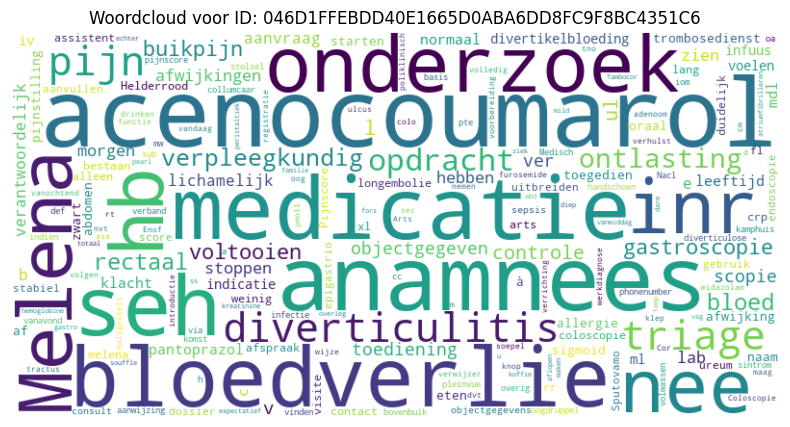

In [141]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def plot_wordcloud(word_freq_dict, id_):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq_dict)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Woordcloud voor ID: {id_}")
    plt.show()

# Visualiseer voor een specifieke ID (bijvoorbeeld de eerste in de lijst)
plot_wordcloud(df_grouped['word_counts'][0], df_grouped['pseudo_id'][0])



In [142]:
from collections import Counter

# Combine words per ID
# df_grouped = df_verslagen_clean.groupby('pseudo_id')['content_words_lemmatized'].apply(lambda x: " ".join(x)).reset_index()

# Compute word frequencies
df_grouped['word_counts'] = df_grouped['content_words_lemmatized'].apply(lambda text: Counter(text.split()))

# Get top 10 words per ID
df_grouped['top_10_words'] = df_grouped['word_counts'].apply(lambda counter: counter.most_common(10))

df_grouped[['pseudo_id', 'top_10_words']].head()


,pseudo_id,top_10_words
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"[(acenocoumarol, 41), (anamnees, 37), (medicat..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,"[(anemie, 255), (oraal, 205), (iv, 203), (os, ..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,"[(oraal, 110), (tablet, 87), (af, 79), (onderz..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,"[(opdracht, 72), (itp, 52), (onderzoek, 50), (..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,"[(poli, 644), (iliaca, 622), (anemie, 542), (c..."


In [143]:
df_grouped

df_grouped['top_10_normalized_words'] = df_grouped['normalized_word_counts'].apply(lambda x: dict(Counter(x).most_common(10)))
df_grouped['top_10_normalized_words_only'] = df_grouped['top_10_normalized_words'].apply(lambda x: list(x.keys()))
df_grouped[['pseudo_id', 'top_10_normalized_words', 'top_10_normalized_words_only']].head()

,pseudo_id,top_10_normalized_words,top_10_normalized_words_only
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"{'acenocoumarol': 0.010007322431047107, 'anamn...","[acenocoumarol, anamnees, medicatie, bloedverl..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,"{'anemie': 0.0083986562150056, 'oraal': 0.0067...","[anemie, oraal, iv, os, psoriasis, poli, onder..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,"{'oraal': 0.009051263062618284, 'tablet': 0.00...","[oraal, tablet, af, onderzoek, behandeling, no..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,"{'opdracht': 0.009135896459840122, 'itp': 0.00...","[opdracht, itp, onderzoek, anamnees, hypertens..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,"{'poli': 0.010860033726812816, 'iliaca': 0.010...","[poli, iliaca, anemie, chronisch, nierinsuffic..."


In [144]:
from collections import Counter

all_top_10_words = [word for sublist in df_grouped['top_10_normalized_words_only'] for word in sublist]
print(all_top_10_words)
# Count the frequency of each word in all_top_10_words
word_counts = Counter(all_top_10_words)
print(word_counts)

['acenocoumarol', 'anamnees', 'medicatie', 'bloedverlie', 'seh', 'onderzoek', 'inr', 'Melena', 'hb', 'nee', 'anemie', 'oraal', 'iv', 'os', 'psoriasis', 'poli', 'onderzoek', 'status', 'okt', 'osteomyelitis', 'oraal', 'tablet', 'af', 'onderzoek', 'behandeling', 'normaal', 'starten', 'wd', 'rivaroxaban', 'pt', 'opdracht', 'itp', 'onderzoek', 'anamnees', 'hypertensie', 'iii', 'af', 'afspraak', 'anemie', 'laat', 'poli', 'iliaca', 'anemie', 'chronisch', 'nierinsufficiëntie', 'stenose', 'hypertensie', 'Ckd', 'onderzoek', 'cva', 'opdracht', 'pouch', 'afspraak', 'poli', 'controle', 'anamnees', 'laboratorium', 'e', 'ileoanaal', 'uitbreiden', 'bloedverlie', 'rbl', 'bloed', 'hb', 'normaal', 'diverticulitis', 'onderzoek', 'rectaal', 'coloscopie', 'bloeding', 'obinutuzumab', 'cll', 'copd', 'opname', 'volgen', 'starten', 'beiderzijds', 'progressie', 'venetoclax', 'I', 'anemie', 'normaal', 'hb', 'onderzoek', 'tablet', 'klinisch', 'struma', 'Clopidogrel', 'oraal', 'bekend', 'anamnees', 'epilepsie', 'ne